# Cut images to few z's

In [1]:
import tifffile as tf
import numpy as np
from pathlib import Path
import pandas as pd
from webfish_tools.util import find_matching_files

In [2]:
# for i in range(65):
#     zslice = []
#     img = tf.imread(f'../deconvoluted_images/HybCycle_{i}/MMStack_Pos0.ome.tif')
#     for z in np.arange(1,13,4):
#         zslice.append(img[z])
#     p = Path(f'../sliced_img/HybCycle_{i}/MMStack_Pos0.ome.tif')
#     p.parent.mkdir(parents=True, exist_ok=True)
#     newslice = np.array(zslice)
#     tf.imwrite(str(p),newslice[:,:3,:,:])

# Custom Dot Detection by Threshold Optimization

In [3]:
#custom function
from dot_detection_threshold_across import dot_detection

In [4]:
import plotly.express as px
import plotly.graph_objects as go
import numpy as np

def plot_2d_locs_on_2d_image(df_locs_2d_1, df_locs_2d_2, img_2d,add_trace = True, zmax=1000):
    
    #For Plotting 2d image
    #-------------------------------------------
    fig = px.imshow(
        img_2d,
        width=700,
        height=700,
        binary_string=True,
        binary_compression_level=4,
        binary_backend='pil',
        zmax = zmax
    )
    #-------------------------------------------
    
    #For Plotting 2d dots
    #-------------------------------------------
    fig.add_trace(go.Scattergl(
        x=df_locs_2d_1.x,
        y=df_locs_2d_1.y,
        mode='markers',
        marker_symbol='cross',
        marker=dict(
            #maxdisplayed=1000,
            size=4
            ),
        name = "Gaussian"
        )
    )
    if add_trace == True:
        fig.add_trace(go.Scattergl(
            x=df_locs_2d_2.x,
            y=df_locs_2d_2.y,
            mode='markers',
            marker_symbol='cross',
            marker=dict(
                #maxdisplayed=1000,
                size=4
                ),
            name = "LoG"
            )
        )
    #-------------------------------------------
    
    fig.show()
    
def plot_3d_locs_on_2d_image(df_tiff_1, df_tiff_2, tiff, channel, 
                             raw_src = None, raw_image = False, add_trace = True, zmax=10):
    
    if raw_image == False:
        if len(tiff.shape) == 3:
            if add_trace == False:
                plot_2d_locs_on_2d_image(df_tiff_1, None, tiff[channel], zmax=zmax, add_trace=add_trace)
            else:
                plot_2d_locs_on_2d_image(df_tiff_1, df_tiff_2, tiff[channel],add_trace=add_trace, zmax=zmax)
        else:
        #PLot All Z's that had dot detection
        #-------------------------------------------
            for z in range(len(tiff[:,channel])):
                if add_trace == False:
                    df_locs_2d_1 = df_tiff_1[(df_tiff_1.z > z-1) & (df_tiff_1.z < z+1)]
                    plot_2d_locs_on_2d_image(df_locs_2d_1, None, tiff[z, channel], zmax=zmax, add_trace=add_trace)
                else:
                    df_locs_2d_1 = df_tiff_1[(df_tiff_1.z > z-1) & (df_tiff_1.z < z+1)]
                    df_locs_2d_2= df_tiff_2[(df_tiff_2.z > z-1) & (df_tiff_2.z < z+1)]
                    plot_2d_locs_on_2d_image(df_locs_2d_1,df_locs_2d_2, tiff[z, channel],add_trace=add_trace, zmax=zmax)
    else:
        #read raw image
        tiff = tf.imread(raw_src)
        print("shape =", tiff.shape)
        #plot
        if len(tiff.shape)==3:
            if add_trace == False:
                plot_2d_locs_on_2d_image(df_tiff_1, None, tiff[channel], zmax=zmax, add_trace=add_trace)
            else:
                plot_2d_locs_on_2d_image(df_tiff_1, df_tiff_2, tiff[channel],add_trace=add_trace, zmax=zmax)
        else:
            for z in range(len(tiff[:,channel])):
                if add_trace == False:
                    df_locs_2d_1 = df_tiff_1[(df_tiff_1.z > z-1) & (df_tiff_1.z < z+1)]
                    plot_2d_locs_on_2d_image(df_locs_2d_1,None, tiff[z, channel], zmax=zmax, add_trace=add_trace)
                else:
                    df_locs_2d_1 = df_tiff_1[(df_tiff_1.z > z-1) & (df_tiff_1.z < z+1)]
                    df_locs_2d_2= df_tiff_2[(df_tiff_2.z > z-1) & (df_tiff_2.z < z+1)]
                    plot_2d_locs_on_2d_image(df_locs_2d_1,df_locs_2d_2, tiff[z, channel],add_trace=add_trace, zmax=zmax)

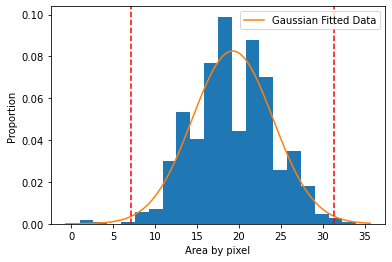

<Figure size 432x288 with 0 Axes>

In [5]:
img_src = '/groups/CaiLab/personal/Lex/raw/20k_dash_062421_brain/notebook_pyfiles/deconvoluted_images/HybCycle_0/MMStack_Pos0.ome.tif'
dot_gaus = dot_detection(img_src, min_sigma = 1.5, max_sigma = 5, 
                  num_sigma = 5, HybCycle=0, size_cutoff=2.5, 
                  opt_thresh=0.001,channel=0,pos=0,choose_thresh_set = 0,check_initial = True,
                  gaussian = True, both = False, optimize=False, output=False)

shape = (5, 2960, 2960)



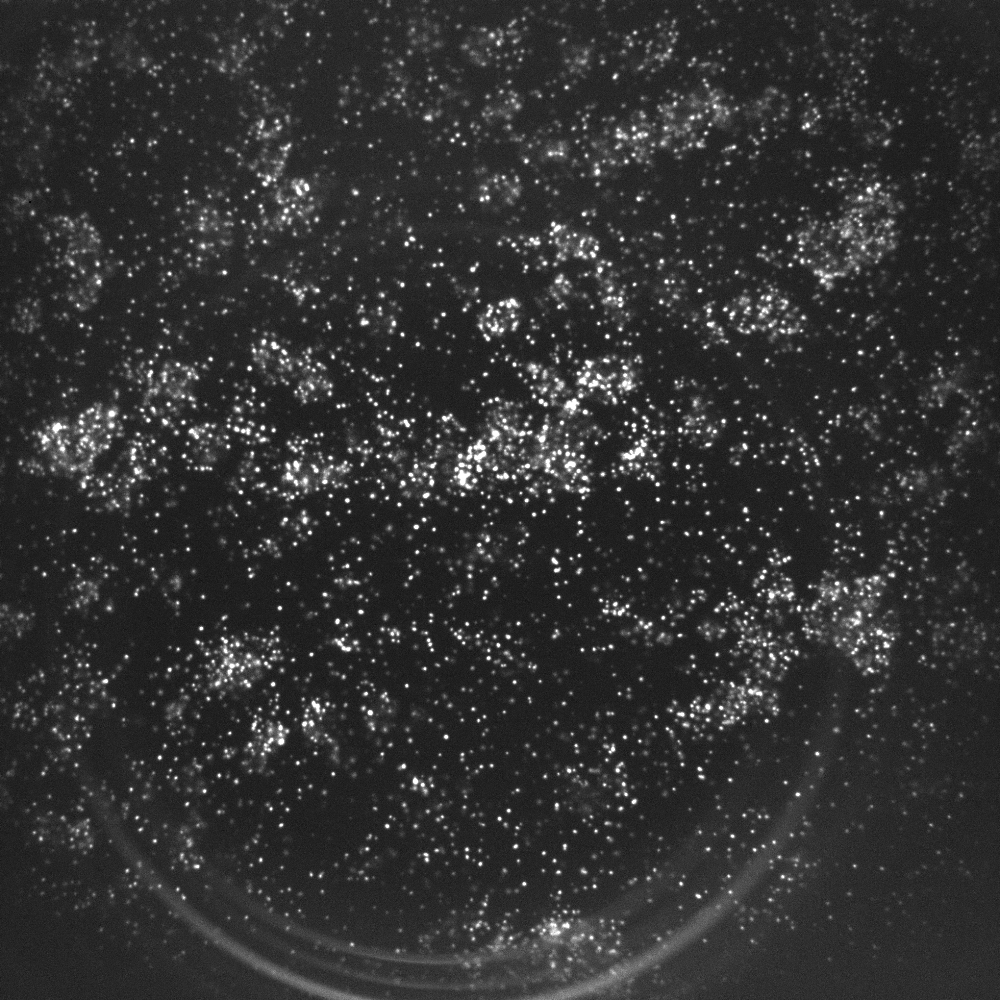

In [6]:
img_raw = '/groups/CaiLab/personal/Lex/raw/20k_dash_062421_brain//HybCycle_0/MMStack_Pos0.ome.tif'
plot_3d_locs_on_2d_image(dot_gaus,None, tiff=None, channel=0, raw_src = img_raw, 
                         raw_image = True, add_trace=False, zmax=2000)


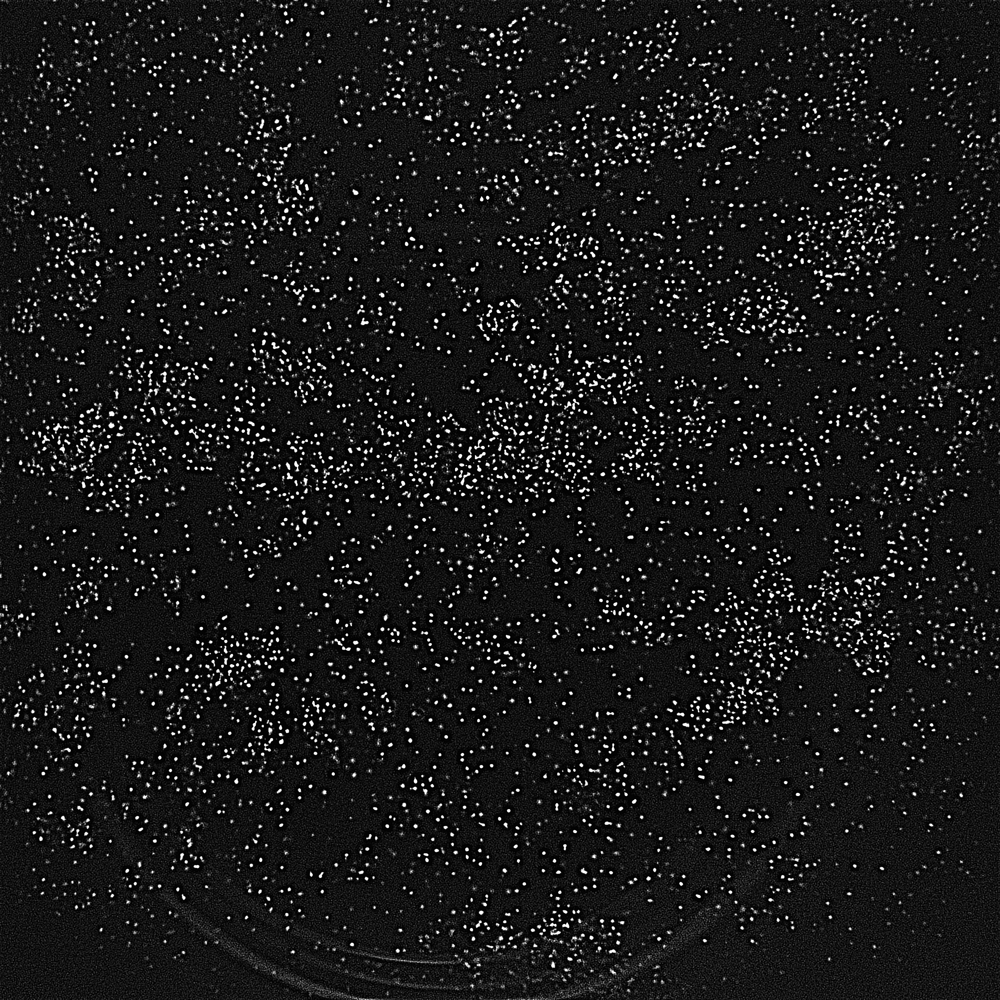

In [7]:
tiff = tf.imread(img_src)
plot_3d_locs_on_2d_image(dot_gaus,None, tiff=tiff, channel=0, 
                         raw_src = img_raw, raw_image = False,add_trace=False, zmax=500)

# Organize dots detected files

In [8]:
#custom functions
from dot_detection_threshold_across import combine_dot_files
#tracking progress
from tqdm import tqdm
#basic package
import numpy as np

In [9]:
path_dots = "/groups/CaiLab/personal/Lex/raw/20k_dash_062421_brain/notebook_pyfiles/dots_detected/"

fails = []
for i in tqdm(np.arange(0,1,1)):
    try:
         combine_dot_files(path_dots, num_HybCycle = 12, pos= i,num_channels = 4, num_z= 1, opt_files = True)
    except:
        fails.append(i)
        continue

  0%|          | 0/1 [00:00<?, ?it/s]

Files passed initial QC for decoding


100%|██████████| 1/1 [00:53<00:00, 53.15s/it]

Files are ready for decoding


In [10]:
fails

[]

# Dot characteristics

In [ ]:
dot_gaus

In [ ]:
import matplotlib.pyplot as plt
from scipy.stats import norm
# Fit a normal distribution 
mu, std = norm.fit(dot_gaus["area"])
plt.hist(dot_gaus["area"], density=True, bins=20)
# Plot the probability distribution functions
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)
plt.plot(x,p)
plt.axvline(mu+(3*std), ls="--", c = "red")
plt.axvline(mu-(3*std), ls="--",c = "red")
plt.show()

In [ ]:
dot_gaus[(dot_gaus["area"] < (mu+(3*std))) & (dot_gaus["area"] > (mu-(3*std)))]

In [ ]:
dot_gaus

In [ ]:
a = np.array([1,2,1,0,1])
b = np.array([0,1,1,0,1,1,1,0])